**Business tangent:** 

What problem/ goal we are trying to solve/ achieve?
1. Advice investors/ retiree/ buyers and providing them with the best asset to invest on.
2. Acknowledging investors of available pre-leased properties with select capital appreciation and long-term security.

Story Telling: The prediction of house prices is increasing based on the predicted data compared with the actual listing prices. In conclusion, investment in housing property is a solid assets. Every year the house prices increases and so there is a profit on house investment. Similarly, some people invest in housing property because of the house price and rent increase every year.

Where should an investor invest? What houses would you recommend they buy as an investment property?

The business use case for a house price prediction project with the given dataset can be to provide valuable insights to real estate companies, property investors, and homeowners who are interested in buying, selling, or renting properties in a specific area.

With the prediction model, we or real estate companies can use it to assist their agents in determining the market value of properties in different locations. Property investors can use the model to identify areas with high potential for capital appreciation or rental income. Homeowners can use the model to estimate the value of their properties when they want to sell or rent them out.

Moreover, the model can also help in making data-driven decisions related to property investments by analyzing the correlation between various features and the house prices. For instance, the model can reveal that houses with a higher walkability score tend to have a higher value in a specific area. This information can assist real estate companies in identifying areas with high demand for walkability, which can potentially increase the value of properties in that area.

In summary, the house price prediction project can be a valuable tool for the real estate industry, providing useful insights and assisting in data-driven decision-making processes.

##Importing Libraries

In [10]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')
from sklearn.preprocessing import LabelEncoder, StandardScaler, MinMaxScaler
from sklearn.metrics import silhouette_score
from scipy.stats import probplot
from sklearn.cluster import SpectralClustering
from sklearn.neighbors import NearestNeighbors
from sklearn.decomposition import PCA
from datetime import date
import itertools
import time
from datetime import datetime
import matplotlib.ticker as mtick
from matplotlib.ticker import FuncFormatter
from sklearn.metrics import mean_squared_error
from scipy import linalg
import matplotlib as mpl
from sklearn import mixture
from scipy.cluster.hierarchy import linkage
from sklearn.cluster import AgglomerativeClustering
from sklearn.cluster import DBSCAN
from sklearn.cluster import MeanShift, estimate_bandwidth
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import RobustScaler
from sklearn import metrics
from matplotlib.colors import ListedColormap
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.neural_network import MLPRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.neighbors import KNeighborsRegressor

names = [
    "Linear Regression",
    "MLP Regressor",
    "RandomForest Regressor",
    "Gradient Boosting Regressor",
    "KNeighbors Regressor"
         ]

classifiers = [
    LinearRegression(),
    MLPRegressor(random_state=1, max_iter=500),
    RandomForestRegressor(max_depth=4, random_state=1),
    GradientBoostingRegressor(random_state=1),
    KNeighborsRegressor(n_neighbors=2)
    ]


from matplotlib.colors import ListedColormap
import seaborn as sns
from warnings import filterwarnings
filterwarnings('ignore')

pd.options.display.max_columns = None

pd.options.display.max_rows = None   
pd.options.display.float_format = '{:.6f}'.format

from sklearn.metrics import classification_report
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score
from sklearn.metrics import confusion_matrix, roc_auc_score, roc_curve, precision_recall_curve
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn import tree
from sklearn.model_selection import GridSearchCV, RandomizedSearchCV, StratifiedKFold

import pydotplus
from IPython.display import Image  
from sklearn import metrics
from sklearn.metrics import classification_report
from sklearn.metrics import cohen_kappa_score
from sklearn.metrics import confusion_matrix
from sklearn.metrics import roc_curve
from sklearn.metrics import accuracy_score

# import various functions from statsmodels
import statsmodels
import statsmodels.api as sm

from collections import Counter
from sklearn.datasets import make_moons, make_circles, make_classification
from sklearn.neural_network import MLPClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.gaussian_process.kernels import RBF
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis


regressors = [
    LinearRegression(),
    MLPRegressor(random_state=1, max_iter=500),
    RandomForestRegressor(max_depth=4, random_state=1),
    GradientBoostingRegressor(random_state=1),
    KNeighborsRegressor(n_neighbors=2)
    ]



In [8]:
!pip install pydotplus

     |████████████████████████████████| 278 kB 4.5 MB/s eta 0:00:01
  Created wheel for pydotplus: filename=pydotplus-2.0.2-py3-none-any.whl size=24575 sha256=fb4ac4cb46b66b561fa49e39b2ee1cd89718fd7a4a6a44325dc76bd7d755af02
  Stored in directory: /Users/soumyendrashrivastava/Library/Caches/pip/wheels/fe/cd/78/a7e873cc049759194f8271f780640cf96b35e5a48bef0e2f36
Successfully built pydotplus


##Dataset1

In [12]:
url1 = 'https://drive.google.com/file/d/1lKFZEqth_T9wFHN2XTxOhSRwFek1hi9Z/view'
url1 ='https://drive.google.com/uc?id=' + url1.split('/')[-2]
data1 = pd.read_csv(url1)
data1.head(10)
# data1 = pd.read_csv('/content/House_Pricing.csv')
# data1.head(10)

,year_built,stories,num_bedrooms,full_bathrooms,half_bathrooms,livable_sqft,total_sqft,garage_type,garage_sqft,carport_sqft,has_fireplace,has_pool,has_central_heating,has_central_cooling,house_number,street_name,unit_number,city,zip_code,sale_price
0,1978,1,4,1,1,1689,1859,attached,508,0,True,False,True,True,42670,Lopez Crossing,NaN,Hallfort,10907,270897.000000
1,1958,1,3,1,1,1984,2002,attached,462,0,True,False,True,True,5194,Gardner Park,NaN,Hallfort,10907,302404.000000
2,2002,1,3,2,0,1581,1578,none,0,625,False,False,True,True,4366,Harding Islands,NaN,Lake Christinaport,11203,2721596.000000
3,2004,1,4,2,0,1829,2277,attached,479,0,True,False,True,True,3302,Michelle Highway,NaN,Lake Christinaport,11203,212968.000000
4,2006,1,4,2,0,1580,1749,attached,430,0,True,False,True,True,582,Jacob Cape,NaN,Lake Christinaport,11203,224529.000000
5,2005,1,3,2,0,1621,1672,attached,430,0,True,False,True,True,78445,Michelle Highway,NaN,Lake Christinaport,11203,212284.000000
6,1979,1,3,2,1,2285,2365,detached,532,0,True,False,True,True,246,Harris Estates,NaN,Morrisport,10924,447738.000000
7,1958,1,5,2,0,1745,1741,none,0,0,False,False,False,False,35725,Jessica Isle,NaN,Lake Christinaport,11203,70078.000000
8,1958,1,5,2,0,1747,1745,none,0,0,False,False,False,False,35725,Jessica Isle,NaN,Lake Christinaport,11203,155127.000000
9,1961,1,1,1,0,998,1161,none,0,242,False,False,False,False,73327,Kurt Crescent,NaN,Lake Christinaport,11203,88448.000000


##Dataset2

In [13]:
url2 = 'https://drive.google.com/file/d/1KAvZblGU7rVfbhSM8S-RvD3jlsucIPyB/view'
url2 ='https://drive.google.com/uc?id=' + url2.split('/')[-2]
data2 = pd.read_csv(url2)
data2.head(10)
# data2 = pd.read_csv('/content/home_sales-formetdate.csv')
# data2.head(10)

,id,date,price,bedrooms,bathrooms,floors,waterfront,view,condition,review_score,basement_size,built,renovation,zipcode,latitude,longitude,living_room_size,lot_size
0,7787980,13/10/2014,221900,3,1,1,0,0,fair,10,0,1955,0,98178,47.5112,-122.257,1340,5650
1,6774848,12/9/2014,538000,3,2.25,2,0,0,fair,7,400,1951,1991,98125,47.721,-122.319,1690,7639
2,6999329,25/2/2015,180000,2,1,1,0,0,fair,8,0,1933,0,98028,47.7379,-122.233,2720,8062
3,7773052,12/9/2014,604000,4,3,1,0,0,excellent,6,910,1965,0,98136,47.5208,-122.393,1360,5000
4,7760818,18/2/2015,510000,3,2,1,0,0,fair,6,0,1987,0,98074,47.6168,-122.045,1800,7503
5,7659918,5/12/2014,1225000,4,4.5,1,0,0,fair,8,1530,2001,0,98053,47.6561,-122.005,4760,101930
6,8057033,27/6/2014,257500,3,2.25,2,0,0,FAIR,7,0,1995,0,98003,47.3097,-122.327,2238,6819
7,7249853,15/1/2015,291850,3,1.5,1,0,0,fair,7,0,1963,0,98198,47.4095,-122.315,1650,9711
8,7906980,15/4/2015,229500,3,1,1,0,0,FAIR,7,730,1960,0,98146,47.5123,-122.337,1780,8113
9,7605289,3/12/2015,323000,3,2.5,2,0,0,fair,7,0,2003,0,98038,47.3684,-122.031,2390,7570


# Cleaning Datasets and amalgamation

In [14]:
data2['year'] = data2['date'].str.split('/').str[2]

In [15]:
data2 = data2.drop(['date', 'waterfront','view','renovation','latitude','longitude','lot_size','living_room_size'], axis = 1)

In [16]:
data1 = data1.drop(['full_bathrooms','half_bathrooms','livable_sqft', 'garage_type','garage_sqft','has_pool','has_fireplace','has_central_heating','has_central_cooling'], axis = 1)

In [17]:
data1.rename(columns = {'year_built':'year','sale_price':'price','zip_code':'zipcode', 'num_bedrooms':'bedrooms'}, inplace = True)

In [18]:
data2.dropna(subset=['price'], inplace=True)
data2['price'] = pd.to_numeric(data2.price, errors='coerce')

In [19]:
data2['year'] = pd.to_numeric(data2['year'], errors='coerce').fillna(-1).astype(int)
data2['zipcode'] = pd.to_numeric(data2['zipcode'], errors='coerce').fillna(-1).astype(int)
data2['bedrooms'] = pd.to_numeric(data2['bedrooms'], errors='coerce').fillna(-1).astype(int)



In [20]:
data2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23154 entries, 0 to 23153
Data columns (total 11 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             23154 non-null  object 
 1   price          21896 non-null  float64
 2   bedrooms       23154 non-null  int64  
 3   bathrooms      23154 non-null  object 
 4   floors         23154 non-null  object 
 5   condition      23154 non-null  object 
 6   review_score   23154 non-null  object 
 7   basement_size  23154 non-null  object 
 8   built          23154 non-null  object 
 9   zipcode        23154 non-null  int64  
 10  year           23154 non-null  int64  
dtypes: float64(1), int64(3), object(7)
memory usage: 1.9+ MB


In [21]:
# data1.dropna()
# data1['year'] = data1.year.astype(int)
data1['year'] = pd.to_numeric(data1['year'], errors='coerce').fillna(-1).astype(int)



In [22]:
data1.head

<bound method NDFrame.head of        year  stories  bedrooms  total_sqft  carport_sqft  house_number  \
0      1978        1         4        1859             0         42670   
1      1958        1         3        2002             0          5194   
2      2002        1         3        1578           625          4366   
3      2004        1         4        2277             0          3302   
4      2006        1         4        1749             0           582   
5      2005        1         3        1672             0         78445   
6      1979        1         3        2365             0           246   
7      1958        1         5        1741             0         35725   
8      1958        1         5        1745             0         35725   
9      1961        1         1        1161           242         73327   
10     2005        1         4        2254             0          3522   
11     2006        1         4        2679             0          1956   
12     2

In [23]:
data1.value_counts()

year  stories  bedrooms  total_sqft  carport_sqft  house_number  street_name          unit_number  city                zipcode  price         
1929  1        1         703         0             377           Ebony Row            511.000000   Lake Carolyn        11140    153843.000000     1
1991  2        2         1000        0             34086         Micheal Walk         582.000000   East Amychester     11205    113656.000000     1
1992  1        3         1163        825           738           Andrea Glen          1367.000000  Jeffreyhaven        11913    29380.000000      1
                         1169        587           46487         Jessica Greens       1896.000000  South Anthony       11353    57459.000000      1
                         1345        0             173           Jordan Points        2144.000000  Jeffreyhaven        11558    40071.000000      1
                         1400        0             5763          Krueger Glen         3818.000000  South Anthony     

In [24]:

data1.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42703 entries, 0 to 42702
Data columns (total 11 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   year          42703 non-null  int64  
 1   stories       42703 non-null  int64  
 2   bedrooms      42703 non-null  int64  
 3   total_sqft    42703 non-null  int64  
 4   carport_sqft  42703 non-null  int64  
 5   house_number  42703 non-null  int64  
 6   street_name   42703 non-null  object 
 7   unit_number   3088 non-null   float64
 8   city          42703 non-null  object 
 9   zipcode       42703 non-null  int64  
 10  price         42703 non-null  float64
dtypes: float64(2), int64(7), object(2)
memory usage: 3.6+ MB


In [25]:



data2.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23154 entries, 0 to 23153
Data columns (total 11 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             23154 non-null  object 
 1   price          21896 non-null  float64
 2   bedrooms       23154 non-null  int64  
 3   bathrooms      23154 non-null  object 
 4   floors         23154 non-null  object 
 5   condition      23154 non-null  object 
 6   review_score   23154 non-null  object 
 7   basement_size  23154 non-null  object 
 8   built          23154 non-null  object 
 9   zipcode        23154 non-null  int64  
 10  year           23154 non-null  int64  
dtypes: float64(1), int64(3), object(7)
memory usage: 1.9+ MB


In [26]:
df = data1.merge(data2, on = ['year', 'zipcode','price','bedrooms'], how = 'outer')

In [27]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 65857 entries, 0 to 65856
Data columns (total 18 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   year           65857 non-null  int64  
 1   stories        42703 non-null  float64
 2   bedrooms       65857 non-null  int64  
 3   total_sqft     42703 non-null  float64
 4   carport_sqft   42703 non-null  float64
 5   house_number   42703 non-null  float64
 6   street_name    42703 non-null  object 
 7   unit_number    3088 non-null   float64
 8   city           42703 non-null  object 
 9   zipcode        65857 non-null  int64  
 10  price          64599 non-null  float64
 11  id             23154 non-null  object 
 12  bathrooms      23154 non-null  object 
 13  floors         23154 non-null  object 
 14  condition      23154 non-null  object 
 15  review_score   23154 non-null  object 
 16  basement_size  23154 non-null  object 
 17  built          23154 non-null  object 
dtypes: flo

# Saving new amalgamated data

In [28]:
df.to_csv('updated_csv.csv')

# Setting up new dataset under study

In [29]:
df = df.drop(['carport_sqft','unit_number','bathrooms','floors','basement_size','condition','built','id'], axis=1)


In [30]:
df.head()

,year,stories,bedrooms,total_sqft,house_number,street_name,city,zipcode,price,review_score
0,1978,1.000000,4,1859.000000,42670.000000,Lopez Crossing,Hallfort,10907,270897.000000,NaN
1,1958,1.000000,3,2002.000000,5194.000000,Gardner Park,Hallfort,10907,302404.000000,NaN
2,2002,1.000000,3,1578.000000,4366.000000,Harding Islands,Lake Christinaport,11203,2721596.000000,NaN
3,2004,1.000000,4,2277.000000,3302.000000,Michelle Highway,Lake Christinaport,11203,212968.000000,NaN
4,2006,1.000000,4,1749.000000,582.000000,Jacob Cape,Lake Christinaport,11203,224529.000000,NaN


In [31]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 65857 entries, 0 to 65856
Data columns (total 10 columns):
 #   Column        Non-Null Count  Dtype  
---  ------        --------------  -----  
 0   year          65857 non-null  int64  
 1   stories       42703 non-null  float64
 2   bedrooms      65857 non-null  int64  
 3   total_sqft    42703 non-null  float64
 4   house_number  42703 non-null  float64
 5   street_name   42703 non-null  object 
 6   city          42703 non-null  object 
 7   zipcode       65857 non-null  int64  
 8   price         64599 non-null  float64
 9   review_score  23154 non-null  object 
dtypes: float64(4), int64(3), object(3)
memory usage: 5.5+ MB


In [32]:
df['price'].value_counts

<bound method IndexOpsMixin.value_counts of 0         270897.000000
1         302404.000000
2        2721596.000000
3         212968.000000
4         224529.000000
5         212284.000000
6         447738.000000
7          70078.000000
8         155127.000000
9          88448.000000
10        333397.000000
11        360616.000000
12        299373.000000
13        379660.000000
14        296655.000000
15        312985.000000
16        243581.000000
17         61234.000000
18        299373.000000
19        156493.000000
20        221126.000000
21        304143.000000
22        251751.000000
23        258548.000000
24        258548.000000
25        342339.000000
26        478167.000000
27       1254328.000000
28       3213004.000000
29       1489951.000000
30        540541.000000
31        353428.000000
32        512819.000000
33        415802.000000
34        415804.000000
35        464313.000000
36       3433500.000000
37        170101.000000
38        265354.000000
39        340203.000

In [33]:


# Check data type and unique values in review_score column
print(df['review_score'].dtype)
print(df['review_score'].unique())

# Replace non-numeric values with NaN
df['review_score'] = pd.to_numeric(df['review_score'], errors='coerce')

# Fill missing values with -1 and convert to integers
df['review_score'] = df['review_score'].fillna(-1).astype(int)


object
[nan '10' '7' '8' '6' '5' 'None' '9' '11' '13' '12' '4' '1' '3']


In [34]:
df.head()

,year,stories,bedrooms,total_sqft,house_number,street_name,city,zipcode,price,review_score
0,1978,1.000000,4,1859.000000,42670.000000,Lopez Crossing,Hallfort,10907,270897.000000,-1
1,1958,1.000000,3,2002.000000,5194.000000,Gardner Park,Hallfort,10907,302404.000000,-1
2,2002,1.000000,3,1578.000000,4366.000000,Harding Islands,Lake Christinaport,11203,2721596.000000,-1
3,2004,1.000000,4,2277.000000,3302.000000,Michelle Highway,Lake Christinaport,11203,212968.000000,-1
4,2006,1.000000,4,1749.000000,582.000000,Jacob Cape,Lake Christinaport,11203,224529.000000,-1


# Exploratory Data Analysis 

<AxesSubplot:xlabel='price'>

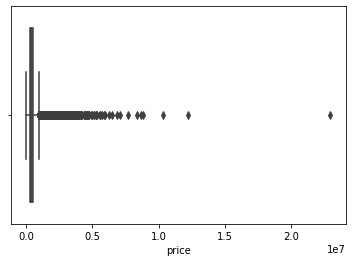

In [35]:
sns.boxplot(x=df['price'])

The Boxplot shows that target variable 'price' has a lot of outliers to deal with.

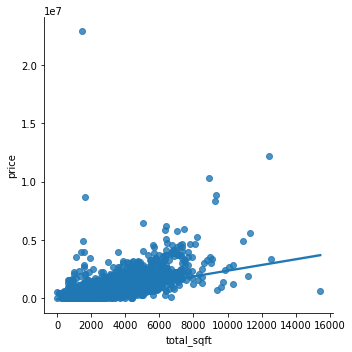

In [36]:

sns.lmplot(x='total_sqft',y='price',data=df)

we can observe a quite good correlation between the square footage and the target

<AxesSubplot:xlabel='bedrooms', ylabel='count'>

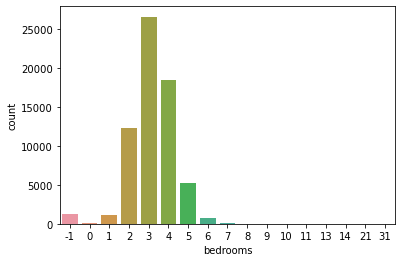

In [37]:
sns.countplot(x='bedrooms',data=df)

apartments with 3 bedrooms are most popular

In [38]:
import plotly.express as ex
ex.pie(df,names='bedrooms',title='bedrooms distribution',hole=0.20)

<AxesSubplot:xlabel='review_score', ylabel='count'>

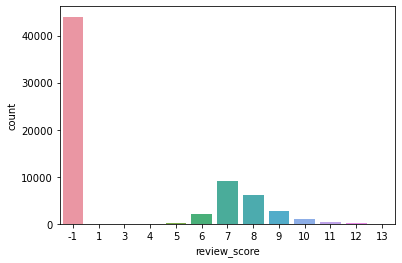

In [39]:
sns.countplot(x='review_score',data=df)

<AxesSubplot:xlabel='stories', ylabel='count'>

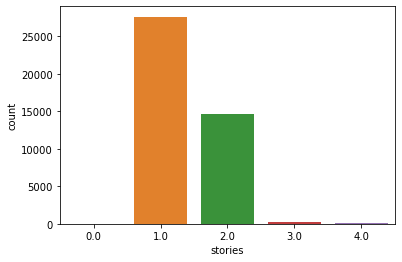

In [40]:

sns.countplot(x='stories',data=df)

1 Story houses or apartments are popular than others

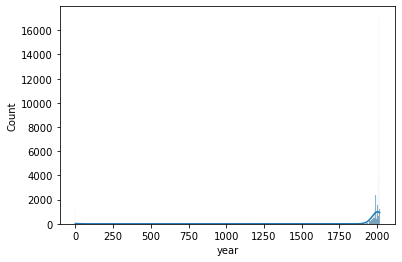

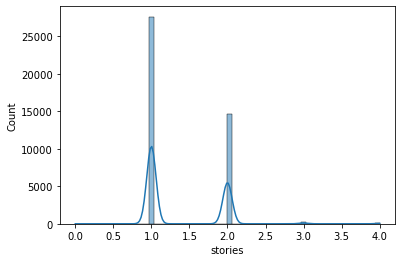

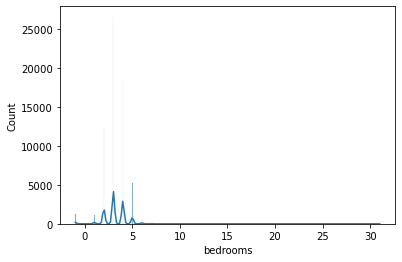

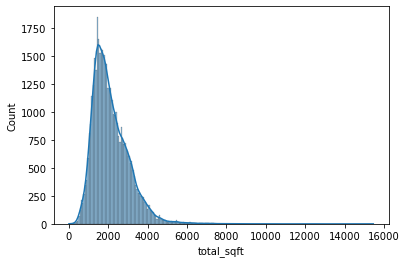

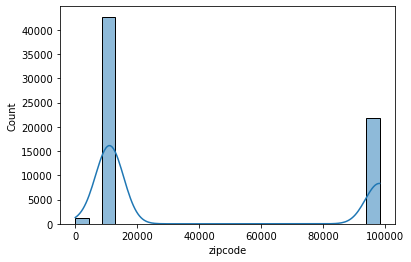

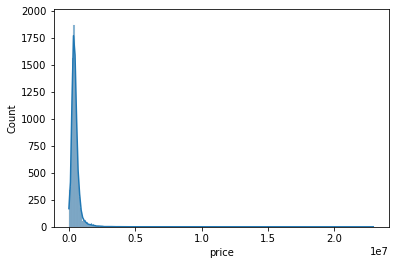

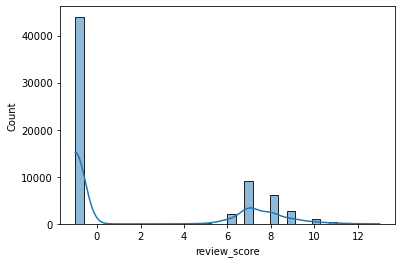

In [41]:
num_cols = ['year',	'stories',	'bedrooms',	'total_sqft',	'zipcode',	'price',	'review_score']
for col in num_cols:
    sns.histplot(df[col], kde = True)
    plt.show()


Data is almost right skewed , let's fix this by using log transformation which is used to transform skewed data to approximately conform to normality

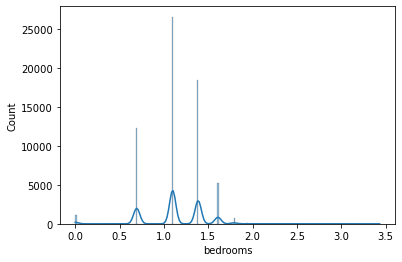

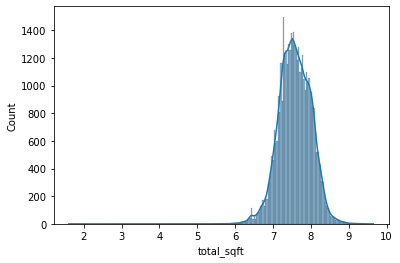

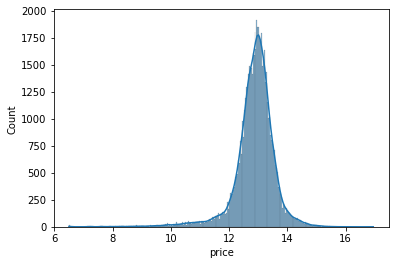

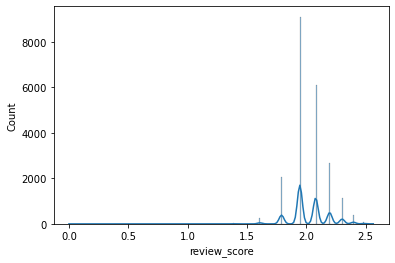

In [42]:
num_cols = ['bedrooms',	'total_sqft',	'price',	'review_score']
for col in num_cols:
    sns.histplot(np.log(df[col]), kde = True)  
    plt.show()

observed some outliers in these columns which we can't fix using log transformation so let's try to fix them manually


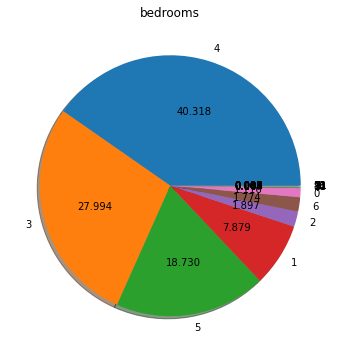

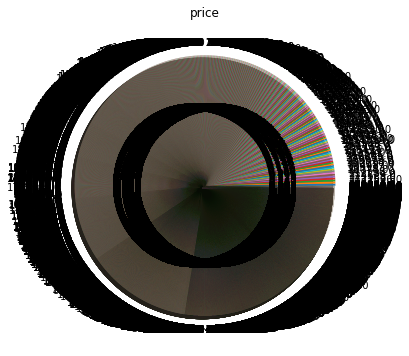

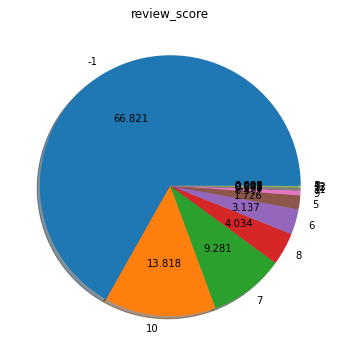

In [43]:
cols = ['bedrooms', 'price', 'review_score']
for col in cols:
    plt.figure(figsize=(6, 6))
    plt.title(col)
    unique_values = df[col].nunique()
    labels = df[col].unique()[:unique_values]
    plt.pie(df[col].value_counts().values[:unique_values], labels=labels, shadow=True, autopct='%.3f')
    plt.show()


In [44]:
cols = ['bedrooms', 'total_sqft', 'price', 'review_score']
for col in cols:
    print(col + ':')
    print(df[col].value_counts())
    print() 

bedrooms:
 3     26552
 4     18436
 2     12335
 5      5189
-1      1249
 1      1168
 6       735
 7        97
 0        42
 8        29
 9         8
 11        5
 10        4
 14        3
 31        3
 13        1
 21        1
Name: bedrooms, dtype: int64

total_sqft:
1446.000000     66
1444.000000     66
1434.000000     65
1442.000000     64
1441.000000     62
1437.000000     62
1440.000000     60
1439.000000     60
1445.000000     59
1438.000000     59
1435.000000     56
1347.000000     53
1436.000000     53
1340.000000     51
1338.000000     51
1344.000000     50
1443.000000     49
1339.000000     49
1349.000000     45
1350.000000     44
1341.000000     44
1244.000000     41
1797.000000     40
1251.000000     39
1635.000000     39
1740.000000     39
1343.000000     39
1345.000000     39
1254.000000     38
1342.000000     38
1494.000000     38
1556.000000     37
1514.000000     37
1518.000000     37
1348.000000     36
1642.000000     36
1550.000000     36
1845.000000     35
1346.

In [45]:
dictt = {'bedrooms': 7,'review_score':10}
bedrooms_replace = [0,8, 9, 10, 11, 13, 14,21,31]
# bathrooms_replace = [7, 8]
# floors_replace = [4]
review_replace = [11,12,13,1,3,4,5]

dictt_replace = {'bedrooms': bedrooms_replace, 'review_score':review_replace}

for col in dictt.keys():
    df[col] = df[col].replace(dictt_replace[col], dictt[col])

In [46]:
cols = ['bedrooms','review_score']
for col in cols:
    print(col + ':')
    print(df[col].value_counts())
    print() 
     

bedrooms:
 3    26552
 4    18436
 2    12335
 5     5189
-1     1249
 1     1168
 6      735
 7      193
Name: bedrooms, dtype: int64

review_score:
-1     44006
 7      9100
 8      6112
 9      2657
 6      2066
 10     1916
Name: review_score, dtype: int64



# Implementing Machine Learning Algorithms

train and Apply algorithms : you can use the muller loop

classify: Muller, at least 5 algos Regression: Muller, at least 7 algos Compare relevant tasks in the same table.

#FRACTAL CLUSTERING

##Dataset3

In [47]:
url3 = 'https://drive.google.com/file/d/1HfTP590blvZIYS3MhlQyZK3or4lgIGaV/view'
url3='https://drive.google.com/uc?id=' + url3.split('/')[-2]
data3 = pd.read_csv(url3)
data3.head()
# data = pd.read_csv("/content/Zip_zhvi_bdrmcnt_3_uc_sfrcondo_tier_0.33_0.67_sm_sa_month.csv")
# data.head()

,RegionID,SizeRank,RegionName,RegionType,StateName,State,City,Metro,CountyName,2000-01-31,2000-02-29,2000-03-31,2000-04-30,2000-05-31,2000-06-30,2000-07-31,2000-08-31,2000-09-30,2000-10-31,2000-11-30,2000-12-31,2001-01-31,2001-02-28,2001-03-31,2001-04-30,2001-05-31,2001-06-30,2001-07-31,2001-08-31,2001-09-30,2001-10-31,2001-11-30,2001-12-31,2002-01-31,2002-02-28,2002-03-31,2002-04-30,2002-05-31,2002-06-30,2002-07-31,2002-08-31,2002-09-30,2002-10-31,2002-11-30,2002-12-31,2003-01-31,2003-02-28,2003-03-31,2003-04-30,2003-05-31,2003-06-30,2003-07-31,2003-08-31,2003-09-30,2003-10-31,2003-11-30,2003-12-31,2004-01-31,2004-02-29,2004-03-31,2004-04-30,2004-05-31,2004-06-30,2004-07-31,2004-08-31,2004-09-30,2004-10-31,2004-11-30,2004-12-31,2005-01-31,2005-02-28,2005-03-31,2005-04-30,2005-05-31,2005-06-30,2005-07-31,2005-08-31,2005-09-30,2005-10-31,2005-11-30,2005-12-31,2006-01-31,2006-02-28,2006-03-31,2006-04-30,2006-05-31,2006-06-30,2006-07-31,2006-08-31,2006-09-30,2006-10-31,2006-11-30,2006-12-31,2007-01-31,2007-02-28,2007-03-31,2007-04-30,2007-05-31,2007-06-30,2007-07-31,2007-08-31,2007-09-30,2007-10-31,2007-11-30,2007-12-31,2008-01-31,2008-02-29,2008-03-31,2008-04-30,2008-05-31,2008-06-30,2008-07-31,2008-08-31,2008-09-30,2008-10-31,2008-11-30,2008-12-31,2009-01-31,2009-02-28,2009-03-31,2009-04-30,2009-05-31,2009-06-30,2009-07-31,2009-08-31,2009-09-30,2009-10-31,2009-11-30,2009-12-31,2010-01-31,2010-02-28,2010-03-31,2010-04-30,2010-05-31,2010-06-30,2010-07-31,2010-08-31,2010-09-30,2010-10-31,2010-11-30,2010-12-31,2011-01-31,2011-02-28,2011-03-31,2011-04-30,2011-05-31,2011-06-30,2011-07-31,2011-08-31,2011-09-30,2011-10-31,2011-11-30,2011-12-31,2012-01-31,2012-02-29,2012-03-31,2012-04-30,2012-05-31,2012-06-30,2012-07-31,2012-08-31,2012-09-30,2012-10-31,2012-11-30,2012-12-31,2013-01-31,2013-02-28,2013-03-31,2013-04-30,2013-05-31,2013-06-30,2013-07-31,2013-08-31,2013-09-30,2013-10-31,2013-11-30,2013-12-31,2014-01-31,2014-02-28,2014-03-31,2014-04-30,2014-05-31,2014-06-30,2014-07-31,2014-08-31,2014-09-30,2014-10-31,2014-11-30,2014-12-31,2015-01-31,2015-02-28,2015-03-31,2015-04-30,2015-05-31,2015-06-30,2015-07-31,2015-08-31,2015-09-30,2015-10-31,2015-11-30,2015-12-31,2016-01-31,2016-02-29,2016-03-31,2016-04-30,2016-05-31,2016-06-30,2016-07-31,2016-08-31,2016-09-30,2016-10-31,2016-11-30,2016-12-31,2017-01-31,2017-02-28,2017-03-31,2017-04-30,2017-05-31,2017-06-30,2017-07-31,2017-08-31,2017-09-30,2017-10-31,2017-11-30,2017-12-31,2018-01-31,2018-02-28,2018-03-31,2018-04-30,2018-05-31,2018-06-30,2018-07-31,2018-08-31,2018-09-30,2018-10-31,2018-11-30,2018-12-31,2019-01-31,2019-02-28,2019-03-31,2019-04-30,2019-05-31,2019-06-30,2019-07-31,2019-08-31,2019-09-30,2019-10-31,2019-11-30,2019-12-31,2020-01-31,2020-02-29,2020-03-31,2020-04-30,2020-05-31,2020-06-30,2020-07-31,2020-08-31,2020-09-30,2020-10-31,2020-11-30,2020-12-31,2021-01-31,2021-02-28,2021-03-31,2021-04-30,2021-05-31,2021-06-30,2021-07-31,2021-08-31,2021-09-30,2021-10-31,2021-11-30,2021-12-31,2022-01-31,2022-02-28,2022-03-31,2022-04-30,2022-05-31,2022-06-30,2022-07-31,2022-08-31
0,91940,0,77449,zip,TX,TX,NaN,"Houston-The Woodlands-Sugar Land, TX",Harris County,96603.000000,96618.000000,96448.000000,96469.000000,96525.000000,96681.000000,96773.000000,96916.000000,97269.000000,97495.000000,97975.000000,98412.000000,98537.000000,98372.000000,97904.000000,97772.000000,97850.000000,98003.000000,98133.000000,97937.000000,97953.000000,98088.000000,98388.000000,98545.000000,98668.000000,98821.000000,99379.000000,99923.000000,100435.000000,100799.000000,101318.000000,101927.000000,102454.000000,102859.000000,103163.000000,103386.000000,103614.000000,103749.000000,104047.000000,104336.000000,104718.000000,104970.000000,105152.000000,105299.000000,105351.000000,105397.000000,105327.000000,105420.000000,105688.000000,106685.000000,108222.000000,109346.000000,110307.000000,110379.000000,111285.000000,111715.000000,112380.000000,112590.000000,113083.000000,113827.000000,114487.000000,114952.000000,115111

We will drop 'StateName' and 'RegionType' due to redundancy, and 'SizeRank' due to it being irrelevant for analysis. 

In [48]:
# Drop unnecessary columns 
data3 = data3.drop(['RegionID', 'StateName', 'RegionType', 'SizeRank'], axis=1)

# Change name of 'RegionName' to 'ZipCode'
data3 = data3.rename(columns={'RegionName': 'ZipCode'})

In [49]:
data3.isna().sum().sum()

1644543

In [50]:
data3.shape

(23404, 277)

### Analyze 'ZipCode'

Next we will look at RegionName, this is the zip code.

In [51]:
data3.ZipCode.value_counts() 

77449    1
35203    1
39464    1
71430    1
17505    1
54984    1
49807    1
65674    1
68372    1
63660    1
49030    1
12138    1
70589    1
94586    1
75833    1
39766    1
21631    1
25248    1
29856    1
73082    1
93675    1
20842    1
39364    1
52046    1
28369    1
12981    1
74080    1
49277    1
53929    1
20733    1
55012    1
65438    1
27845    1
44040    1
72662    1
41080    1
52591    1
38737    1
65606    1
30833    1
12788    1
45623    1
37724    1
18977    1
93626    1
60194    1
8750     1
45786    1
78832    1
95237    1
16222    1
7756     1
18709    1
3269     1
24445    1
14098    1
2668     1
80117    1
41003    1
20675    1
76577    1
64054    1
98844    1
93242    1
27053    1
41086    1
4756     1
44452    1
74764    1
24162    1
49614    1
49878    1
44840    1
37373    1
26570    1
35987    1
74119    1
52208    1
81125    1
18837    1
16630    1
97539    1
37338    1
1360     1
20137    1
75416    1
36474    1
32094    1
62640    1
15419    1
29080    1

All zipcodes are unique. Changing to string

In [52]:
data3.ZipCode = data3.ZipCode.astype('string')

In [53]:
data3[['ZipCode', 'State']].sort_values(by=['ZipCode'])

,ZipCode,State
4646,10001,NY
137,10002,NY
655,10003,NY
11591,10005,NY
9650,10007,NY
453,10009,NY
6834,1001,MA
2312,10010,NY
950,10011,NY
5292,10012,NY


In [54]:
data3.ZipCode.count()

23404

### Analyze 'City'

In [55]:
data3.City.nunique()

11311

In [56]:
data3.City.isna().sum()

1085

In [57]:
data3.City.fillna('None', inplace=True)

### Analyze 'Metro'

Fillna with None

In [58]:
print(data3.Metro.value_counts())
print(data3.Metro.nunique())

New York-Newark-Jersey City, NY-NJ-PA             793
Chicago-Naperville-Elgin, IL-IN-WI                368
Los Angeles-Long Beach-Anaheim, CA                355
Philadelphia-Camden-Wilmington, PA-NJ-DE-MD       316
Washington-Arlington-Alexandria, DC-VA-MD-WV      292
Boston-Cambridge-Newton, MA-NH                    269
Dallas-Fort Worth-Arlington, TX                   249
Pittsburgh, PA                                    242
Minneapolis-St. Paul-Bloomington, MN-WI           215
Houston-The Woodlands-Sugar Land, TX              213
Detroit-Warren-Dearborn, MI                       210
Atlanta-Sandy Springs-Alpharetta, GA              197
St. Louis, MO-IL                                  189
Miami-Fort Lauderdale-Pompano Beach, FL           180
Kansas City, MO-KS                                175
Cincinnati, OH-KY-IN                              148
Seattle-Tacoma-Bellevue, WA                       148
Phoenix-Mesa-Chandler, AZ                         146
Riverside-San Bernardino-Ont

In [59]:
data3.Metro.fillna('None', inplace=True)

In [60]:
data3.Metro.value_counts()

None                                              4206
New York-Newark-Jersey City, NY-NJ-PA              793
Chicago-Naperville-Elgin, IL-IN-WI                 368
Los Angeles-Long Beach-Anaheim, CA                 355
Philadelphia-Camden-Wilmington, PA-NJ-DE-MD        316
Washington-Arlington-Alexandria, DC-VA-MD-WV       292
Boston-Cambridge-Newton, MA-NH                     269
Dallas-Fort Worth-Arlington, TX                    249
Pittsburgh, PA                                     242
Minneapolis-St. Paul-Bloomington, MN-WI            215
Houston-The Woodlands-Sugar Land, TX               213
Detroit-Warren-Dearborn, MI                        210
Atlanta-Sandy Springs-Alpharetta, GA               197
St. Louis, MO-IL                                   189
Miami-Fort Lauderdale-Pompano Beach, FL            180
Kansas City, MO-KS                                 175
Cincinnati, OH-KY-IN                               148
Seattle-Tacoma-Bellevue, WA                        148
Phoenix-Me

### Analyze 'CountyName'

In [61]:
data3.CountyName.value_counts()

Washington County                275
Los Angeles County               268
Jefferson County                 260
Montgomery County                215
Franklin County                  201
Orange County                    198
Jackson County                   176
Cook County                      165
Wayne County                     156
Madison County                   146
Middlesex County                 144
Marion County                    141
Monroe County                    137
Harris County                    136
Polk County                      131
Clark County                     126
Maricopa County                  126
Suffolk County                   125
Lake County                      120
Hamilton County                  113
Lincoln County                   111
Douglas County                   108
Essex County                     103
Fayette County                   100
Johnson County                    96
Greene County                     95
Dallas County                     95
S

In [62]:
data3.isna().sum()

ZipCode           0
State             0
City              0
Metro             0
CountyName        0
2000-01-31    11803
2000-02-29    11720
2000-03-31    11699
2000-04-30    11682
2000-05-31    11638
2000-06-30    11627
2000-07-31    11614
2000-08-31    11586
2000-09-30    11572
2000-10-31    11565
2000-11-30    11543
2000-12-31    11526
2001-01-31    11409
2001-02-28    11352
2001-03-31    11308
2001-04-30    11283
2001-05-31    11272
2001-06-30    11260
2001-07-31    11252
2001-08-31    11226
2001-09-30    11172
2001-10-31    11142
2001-11-30    11107
2001-12-31    11096
2002-01-31    11063
2002-02-28    11038
2002-03-31    11019
2002-04-30    10905
2002-05-31    10911
2002-06-30    10816
2002-07-31    10812
2002-08-31    10758
2002-09-30    10752
2002-10-31    10728
2002-11-30    10716
2002-12-31    10711
2003-01-31    10649
2003-02-28    10609
2003-03-31    10592
2003-04-30    10576
2003-05-31    10551
2003-06-30    10534
2003-07-31    10492
2003-08-31    10460
2003-09-30    10417


In [63]:
data3.CountyName.fillna('None', inplace=True)

### Drop sales data that have missing values

In [ ]:
data3[data3['2000-01-31'].isna()]

In [ ]:
# All zipcodes have some data
data3[data3['2022-06-30'].isna()]

In [ ]:
def melt_data(data3):
    melted = pd.melt(data3,
                     id_vars=['ZipCode', 'State', 'City', 'Metro', 'CountyName'],
                     var_name='Date')
    melted['Date'] = pd.to_datetime(melted['Date'], infer_datetime_format=True)
    melted = melted.dropna(subset=['value'])
    return melted

In [ ]:
melted_data = melt_data(data3)
melted_data.info()

In [ ]:
# Make sure the data type of the 'Date' column is datetime
melted_data['Date'] = pd.to_datetime(melted_data['Date'], format='%Y/%m')

# Set the 'Date' columns as index
melted_data.set_index('Date', inplace=True)

melted_data.info

In [ ]:
melted_data.head()

### EDA on ZipCodes

In [ ]:
print('Average home value' ,round(data3['2022-08-31'].mean()))

In [ ]:
#Average Home Value by Month and Year
month_data = melted_data['value'].resample('MS').mean()
month_data = month_data.fillna(month_data.bfill())
month_data.plot(figsize=(12,5), color='red')
plt.title('Average Home Value By Month')
plt.ylabel('Value')
plt.show()

In [ ]:
yr_data = melted_data['value'].resample('A').mean()
yr_data.plot.line(figsize=(12,5), color='orange')
plt.title('Average Home Value By Year')
plt.ylabel('Value')
plt.show()

### Top 10 Metro and County (mean)

In [ ]:
# Get Mean Home Value by metro
metro = melted_data.groupby('Metro')
metro = metro.value.mean()
metro = metro.sort_values(ascending=False).head(10)

# Plot Mean Home Value by Metro
metro.plot.barh(figsize=(12,7), color='blue')
plt.title('10-Year Mean Value by Metro')
plt.xlabel('Value in Millions of Dollars ($)')
plt.show()

In [ ]:
# Get Mean Home Value by County
county = melted_data.groupby('CountyName')
county = county.value.mean()
county = county.sort_values(ascending=False).head(10)

# Plot Mean Home Value by County
county.plot.barh(figsize = (12,7), color='darkgreen')
plt.title('10-Year Mean Value by County')
plt.xlabel('Value in Millions of Dollars ($)')
plt.ylabel('County Name')
plt.show()

### Most recent one year ROI

In [ ]:
# Check out most recent 1 year ROI
data3['recent_1_yr_ROI'] = (data3['2022-08-31'] - data3['2021-08-31'])/(data3['2021-08-31'])
data3['recent_1_yr_ROI']

In [ ]:
# Lowest Values
data3.sort_values('recent_1_yr_ROI').head()[['ZipCode', 'City', 'recent_1_yr_ROI']]

In [ ]:
# Highest Values 
data3.sort_values('recent_1_yr_ROI', ascending=False).head()[['ZipCode', 'City', 'recent_1_yr_ROI']]

In [ ]:
def average_one_year_ROI(data3):
    average_one_year_ROI = []
    for i in range(len(data3)):
        year_1_ROI = data3['recent_1_yr_ROI'][i]
        year_2_ROI = (data3.iloc[i,-15] - data3.iloc[i,-27])/data3.iloc[i,-27]
        year_3_ROI = (data3.iloc[i,-27] - data3.iloc[i,-39])/data3.iloc[i,-39]
        avg_ROI = (year_1_ROI + year_2_ROI + year_3_ROI)/3
        average_one_year_ROI.append(avg_ROI)
    return average_one_year_ROI   

In [ ]:
data3['avg_one_yr_ROI'] = average_one_year_ROI(data3)

In [ ]:
data_top = data3[(data3['2022-08-31'] < 100000) & (data3['avg_one_yr_ROI'] > 0.20)]
data_top

In [ ]:
data_top[['ZipCode', 'City','State','Metro','2022-08-31','avg_one_yr_ROI']]

In [ ]:
train_df3 = data3.iloc[:,5:275]
train_df3['Y'] = data3['ZipCode']
train_df3 = train_df3.dropna()
train_df3.head(15)

In [ ]:
train_df3.head(15)

In [ ]:
from sklearn.model_selection import train_test_split
train_df3_y = train_df3['Y']
train_df3 = train_df3.drop('Y', axis = 1)
X_train3, X_test3, Y_train3, Y_test3 = train_test_split(train_df3,train_df3_y, test_size=0.33, random_state=4)

## Fractal Clustering Functions

In [ ]:
from sklearn.preprocessing import RobustScaler
from sklearn.cluster import KMeans
from sklearn import metrics

In [ ]:
def plot_cluster(data3, max_loop=50):
    try:
        data3.drop('cluster', axis=1, inplace=True)
    except:
        next
    X = data3.iloc[:,1:]
    rb = RobustScaler()
    X_rb = rb.fit_transform(X)
    
    sse_within_cluster = {}
    silhouette_score = {}
    
    for k in range(2, max_loop):
        kmeans = KMeans(n_clusters=k,  random_state=10, n_init=10)
        kmeans.fit(X_rb)
        sse_within_cluster[k] = kmeans.inertia_
        silhouette_score[k] = metrics.silhouette_score(X_rb, kmeans.labels_, random_state=10)

    _ = plt.figure(figsize=(10,6))
    ax1 = plt.subplot(211)
    _ = plt.plot(list(sse_within_cluster.keys()), list(sse_within_cluster.values()))
    _ = plt.xlabel("Number of Clusters")
    _ = plt.ylabel("SSE Within Cluster")
    _ = plt.title("Within Cluster SSE After K-Means Clustering")
    _ = plt.xticks([i for i in range(2, max_loop)], rotation=75)
    
    ax2 = plt.subplot(212)
    _ = plt.plot(list(silhouette_score.keys()), list(silhouette_score.values()))
    _ = plt.xlabel("Number of Clusters")
    _ = plt.ylabel("Silhouette Score")
    _ = plt.title("Silhouette Score After K-Means Clustering")
    _ = plt.xticks([i for i in range(2, max_loop)], rotation=75)
    
    plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.5, wspace=0.35)


In [ ]:
def apply_cluster(df3, clusters=2):
    try:
        df3.drop('cluster', axis=1, inplace=True)
    except:
        next
    X = df3.iloc[:,1:]
    rb = RobustScaler()
    X_rb = rb.fit_transform(X)
    kmeans = KMeans(n_clusters=clusters, random_state=10, n_init=10)  
    kmeans.fit(X_rb) 
    score = metrics.silhouette_score(X_rb, kmeans.labels_, random_state=10)
    df3['cluster'] = kmeans.labels_
    sse_within_cluster = kmeans.inertia_
    
    print("clustering performance")
    print("#############################")
    print("silhouette score: " + str(score.round(2)))
    print("sse withing cluster: " + str(sse_within_cluster))
    
    return df3

In [ ]:
change_df3 = data3.iloc[:, 5:275]
change_df3 = change_df3.pct_change(axis=1)

In [ ]:
change_df3['Mean'] = change_df3.mean(axis = 1).round(decimals = 3)
change_df3.head()

In [ ]:
change_df3['Mean'].value_counts().plot.pie()

In [ ]:
change_df3_train = change_df3.iloc[:,1:].dropna().drop('Mean',axis=1)

In [ ]:
change_df3_train.head()

In [ ]:
plot_cluster(train_df3, max_loop=25)

Optimal Cluster  = 3

### First Iteration

In [ ]:
first_trial = apply_cluster(change_df3_train, clusters=3)

In [ ]:
cluster_perf_df3 = first_trial.groupby('cluster')
cluster_perf_df3['cluster'].value_counts()

In [ ]:
colors = ['#DF2020', '#81DF20', '#2095DF']
first_trial['c'] = first_trial.cluster.map({0:colors[0], 1:colors[1], 2:colors[2]})
first_trial['Y'] = data3['ZipCode']
first_trial.head()

In [ ]:
plt.scatter(first_trial['2000-02-29'], first_trial['2022-06-30'],c=first_trial.c, alpha = 0.6, s=10)

### Second Iteration

In [ ]:
dataf3 = first_trial.query("cluster == 0").reset_index(drop=True).drop(['c', 'Y'], axis=1)

In [ ]:
plot_cluster(dataf3, max_loop=25)

**Optimal Cluster** is 3.

In [ ]:
second_trial= apply_cluster(dataf3, clusters=3)

In [ ]:
cluster_perf_df3 = second_trial.groupby('cluster')
cluster_perf_df3['cluster'].value_counts()

In [ ]:
colors = ['#FFFFFF', '#3cb44b','#FFFFFF']
second_trial['c'] = second_trial.cluster.map({0:colors[0], 1:colors[1], 2:colors[2]})
second_trial['Y'] = data3['ZipCode']
second_trial.head()

In [ ]:
plt.scatter(second_trial['2000-02-29'], second_trial['2022-06-30'],c=second_trial.c, alpha = 0.6, s=10)

After the second iteration we again found two prominent clusters, thus we will dive deeper and perform a third iteration on the more prominent cluster.

### Third Iteration

In [ ]:
dataf4 = second_trial.query("cluster == 1").reset_index(drop=True).drop(['c', 'Y'], axis=1)

In [ ]:
plot_cluster(dataf4, max_loop=25)

**Optimal Cluster** is 3.

In [ ]:
third_trial = apply_cluster(dataf4, clusters=3)

In [ ]:
cluster_perf_df3 = third_trial.groupby('cluster')
cluster_perf_df3['cluster'].value_counts()

In [ ]:
colors = ['#e6194b', '#3cb44b', '#2095DF' ]
third_trial['c'] = third_trial.cluster.map({0:colors[0], 1:colors[1], 2:colors[2]})
third_trial['Y'] = data3['ZipCode']
third_trial.head()

In [ ]:
plt.scatter(third_trial['2000-02-29'], third_trial['2022-06-30'],c=third_trial.c, alpha = 0.6, s=10)

In [ ]:
cluster_perf_df3['cluster'].value_counts()

On performing the third iteration we found that 2 clusters are almost shared divided. Hence, one prominent cluster from iteration 2 itself will become our **Golden Cluster**.

In [ ]:
change_df3_train = change_df3.iloc[:,1:].dropna().drop('Mean',axis=1)

In [ ]:
change_df3_train.head(15)

In [ ]:
change_df3_train.head

# Agglomerative Clustering

## Applying Agglomerative Clustering and plot

In [ ]:
plt.figure(figsize=(15,10))
d1 = AgglomerativeClustering(n_clusters=3, affinity='euclidean', linkage='ward')
agglo_pred = d1.fit_predict(change_df3_train)
cluster_labels = d1.labels_
print('Agglomerative Clustering Using Ward Method')
print(agglo_pred)
plt.scatter(change_df3_train['2000-02-29'], change_df3_train['2022-06-30'], cmap = 'rainbow', label = 'Cluster 1')
plt.scatter(change_df3_train['2000-02-29'], change_df3_train['2022-06-30'], cmap = 'rainbow', label = 'Cluster 2')
plt.scatter(change_df3_train['2000-02-29'], change_df3_train['2022-06-30'], cmap = 'rainbow', label = 'Cluster 3')
plt.scatter(change_df3_train['2000-02-29'], change_df3_train['2022-06-30'], c=d1.labels_, cmap='rainbow')
plt.title('Agglomerative Ward Clustering')
# plt.xticks([i for i in range(0, 5)], rotation=360)
# plt.yticks([i for i in range(0, 5)], rotation=360)
plt.legend()
plt.show()

## Silhouette Score

In [ ]:
score = metrics.silhouette_score(change_df3_train, cluster_labels, metric='euclidean', random_state=10)
print("silhouette score: " + str(score.round(2)))

# DBSCAN

## Scaling 

In [ ]:
Sc = StandardScaler()
X = Sc.fit_transform(change_df3_train)


## PCA for dimensionality reduction

In [ ]:
from sklearn.decomposition import PCA

pca = PCA(n_components=2)
vis = pca.fit_transform(X)
print(vis)
plt.scatter(vis[:,0], vis[:, 1], s=8)

## Applying DBSCAN

In [ ]:
# Compute DBSCAN
db = DBSCAN(eps=0.3, min_samples=10).fit(vis)
plt.figure(figsize=(10,7))
dbsc_labels=db.labels_
plt.scatter(vis[:,0], vis[:, 1], s=7, c=dbsc_labels)
plt.colorbar()
print("Silhouette Coefficient: %0.3f" % metrics.silhouette_score(X, dbsc_labels))

In [ ]:
pd.Series(db.labels_).value_counts()

# Spectral Clustering

In [ ]:
def plot_cluster_spectral(df3, max_loop=50):
    try:
        df3.drop('cluster', axis=1, inplace=True)
    except:
        next
    X3 = df3.iloc[:,1:].values    
    rb = RobustScaler()
    X3_rb = rb.fit_transform(X)

    silhouette_score = {}

    for k in range(2, max_loop):
        cluster_labels = SpectralClustering(n_clusters=k, assign_labels='discretize', random_state=10, affinity='rbf').fit_predict(X3_rb)
        silhouette_score[k] = metrics.silhouette_score(X3_rb, cluster_labels, random_state=10)

    ax2 = plt.subplot(212)
    _ = plt.plot(list(silhouette_score.keys()), list(silhouette_score.values()))
    _ = plt.xlabel("Number of Clusters")
    _ = plt.ylabel("Silhouette Score")
    _ = plt.title("Silhouette Score After Spectral Clustering")
    _ = plt.xticks([i for i in range(2, max_loop)], rotation=75)
    
    plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.5, wspace=0.35)

In [ ]:
plot_cluster_spectral(change_df3_train, 10)

**Comparing the Silhoeutte Scores, it can be found that Agglomerative Clustering is best suited for this modelling.**

# Applying Agglomerative clustering with fractal distance 

In [ ]:
!pip install pyclustering

In [ ]:
def fractal_distance(p1, p2): 
  x1, y1, x2, y2 = p1[0],p1[1], p2[0], p2[1]
  num_divisions = 10
  # Create a grid with num_divisions x num_divisions boxes
  x = np.linspace(min(x1, x2), max(x1, x2), num_divisions + 1) 
  y = np.linspace(min(y1, y2), max(y1, y2), num_divisions + 1) 
  grid = np.zeros((num_divisions, num_divisions))
  
  # Place a point at each of the two endpoints
  x1_idx = np.argmin(np.abs(x - x1)) - 1
  y1_idx = np.argmin(np.abs(y - y1)) - 1
  grid[y1_idx, x1_idx] = 1
  x2_idx = np.argmin(np.abs(x - x2)) - 1
  y2_idx = np.argmin(np.abs(y - y2)) - 1
  grid[y2_idx, x2_idx] = 1

  # Count the number of boxes that contain at least one point 
  num_boxes_with_points = 0
  for i in range(num_divisions):
    for j in range(num_divisions):
      if np.sum(grid[i:i+2, j:j+2]) > 0:
        num_boxes_with_points += 1
  
  # Calculate the fractal dimension and use it to estimate the length of the path
  fractal_dim = np.log(num_boxes_with_points) / np.log(2)
  fractal_length = (2 ** fractal_dim) * ((x2 - x1) ** 2 + (y2 - y1) ** 2) ** 0.5
  return fractal_length

In [ ]:


def plot_cluster_agglo(df3, max_loop=50):
    try:
        df3.drop('cluster', axis=1, inplace=True)
    except:
        next
    XX = df3.iloc[:,1:].values    
    rb = RobustScaler()
    XX_rb = rb.fit_transform(XX)

    def sim_affinity(XX):
      return metrics.pairwise_distances(XX, metric=fractal_distance)

    silhouette_score = {}
    
    for k in range(2, max_loop):
        instance = AgglomerativeClustering(n_clusters=k, affinity=sim_affinity, linkage='average')
        instance.fit_predict(XX_rb)
        cluster_labels = instance.labels_
        silhouette_score[k] = metrics.silhouette_score(XX_rb, cluster_labels, random_state=10)

    _ = plt.figure(figsize=(10,6))
    
    ax1 = plt.subplot(212)
    _ = plt.plot(list(silhouette_score.keys()), list(silhouette_score.values()))
    _ = plt.xlabel("Number of Clusters")
    _ = plt.ylabel("Silhouette Score")
    _ = plt.title("Silhouette Score After Agglomerative Clustering")
    _ = plt.xticks([i for i in range(2, max_loop)], rotation=75)
    
    plt.subplots_adjust(top=0.92, bottom=0.08, left=0.10, right=0.95, hspace=0.5, wspace=0.35)


In [ ]:
change_df3_train = change_df3.iloc[:,1:].dropna().drop('Mean',axis=1)

In [ ]:
plot_cluster_agglo(change_df_train, 10)

In [ ]:
def apply_cluster_agglo(df3, clusters=2):
    try:
        df3.drop('cluster', axis=1, inplace=True)
    except:
        next
    XX = df3.iloc[:,1:]
    rb = RobustScaler()
    XX_rb = rb.fit_transform(XX)
    def sim_affinity(XX):
      return metrics.pairwise_distances(XX, metric=fractal_distance)

    instance = AgglomerativeClustering(n_clusters=clusters, affinity=sim_affinity, linkage='average')
    instance.fit_predict(XX_rb)
    score = metrics.silhouette_score(XX_rb, instance.labels_, random_state=10)
    df3['cluster'] = instance.labels_
    # sse_within_cluster = kmeans.inertia_
    
    print("clustering performance")
    print("######################")
    print("silhouette score: " + str(score.round(2)))
    
    return df3

# Fractal Clustering on Best performing algorithm

In [ ]:
change_df3_train1= change_df3.iloc[:,1:].dropna().drop('Mean',axis=1)
change_df3_train1.head()

In [ ]:
plot_cluster_agglo(change_df3_train1, 25)

In [ ]:
first_trial_agglo = apply_cluster_agglo(change_df_train1, clusters=3)

In [ ]:
cluster_df_agglo = first_trial_agglo.groupby('cluster')
cluster_df_agglo['cluster'].value_counts()

In [ ]:
colors = ['#DF2020', '#81DF20', '#2095DF']
first_trial_agglo['c'] = first_trial_agglo.cluster.map({0:colors[0], 1:colors[1], 2:colors[2]})
first_trial_agglo['Y'] = data3['ZipCode']
first_trial_agglo.head()

In [ ]:
plt.scatter(first_trial_agglo['2000-02-29'], first_trial_agglo['2022-06-30'],c=first_trial_agglo.c, alpha = 0.6, s=10)

In [ ]:
dataf5 = first_trial_agglo.query("cluster == 2").reset_index(drop=True).drop(['c', 'Y'], axis=1)

In [ ]:
dataf5.head()

In [ ]:
plot_cluster_agglo(dataf5,10)

In [ ]:
second_trial_agglo= apply_cluster_agglo(dataf5, clusters=3)

In [ ]:
cluster_df3_agglo2 = second_trial_agglo.groupby('cluster')
cluster_df3_agglo2['cluster'].value_counts()

In [ ]:
colors = ['#FFFFFF', '#3cb44b','#FFFFFF']
second_trial_agglo['c'] = second_trial_agglo.cluster.map({0:colors[0], 1:colors[1], 2:colors[2]})
second_trial_agglo['Y'] = data3['ZipCode']
second_trial_agglo.head()

In [ ]:
plt.scatter(second_trial_agglo['2000-02-29'], second_trial_agglo['2022-06-30'],c=second_trial_agglo.c, alpha = 0.6, s=10)

#Latent Variables and Manifolds

We scraped a beautiful dataset consisting of predominant latent variables which can be the form factors while choosing the right house. These latent variables predominantly act as a characteristic feature for houses which indirectly may impact on the popularity, pricing and considerations of houses of that location. For the location, we scraped walkability, mix of employment types in a block group (such as retail, office, or industrial), percentage of workers that are low, medium, or high wage (by home and work locations).

###Dataset4

In [ ]:
url4 = 'https://drive.google.com/file/d/1p4BNeW3kp7-Ruiukio3q25O_SA2pICCY/view'
url4 ='https://drive.google.com/uc?id=' + url4.split('/')[-2]
data4 = pd.read_csv(url4)
data4.head(10)

In [ ]:
data4['RegionName'].unique()

## Importing another dataset for Latent Variables

In [ ]:
#walkability_url = 'https://drive.google.com/file/d/1yCz6FYet7_dwq4sHQxc67xcujvQbxTuU/view'
#walkability_url ='https://drive.google.com/uc?id=' + walkability_url.split('/')[-2]
walkability_df = pd.read_csv('/content/EPA_SmartLocationDatabase_V3_Jan_2021_Final (1).csv')
walkability_df.head()

In [ ]:
walkability_df['CSA_Name'].unique()

### Mapping Latent Variables

In [ ]:
data_mapper = set(data4['RegionName'])
print(data_mapper)

In [ ]:
def lv_mapper(column):
  idx_mapper = dict(walkability_df.groupby(['CSA_Name'])[column].mean())
  idx_data_mapper = {}

  for d in data_mapper:
    for i in idx_mapper:
      if d.split(',')[0] in i:
        idx_data_mapper[d] = idx_mapper[i]
        break
  return idx_data_mapper

In [ ]:
data4 = data4.fillna(method="ffill")

In [ ]:
nwi_mapper = lv_mapper('NatWalkInd')
met_mapper = lv_mapper('D2B_E8MIXA')
data4['NatWalkInd'] = data4['RegionName'].map(nwi_mapper)
data4['D2B_E8MIXA'] = data4['RegionName'].map(met_mapper)
data4.head()

### Train Test Split

In [ ]:
from sklearn.model_selection import train_test_split

In [ ]:
train_data_nlv = data4.drop(columns=['RegionID','RegionType','StateName', 'SizeRank'])
train_data_nlv_x = train_data_nlv[['2000-12-31', '2001-12-31', '2002-12-31', '2003-12-31', '2004-12-31', '2005-12-31', '2006-12-31', '2007-12-31', '2008-12-31','2009-12-31','2010-12-31', '2011-12-31', '2012-12-31', '2013-12-31', '2014-12-31','2015-12-31', '2016-12-31', '2017-12-31', '2018-12-31', '2019-12-31', '2020-12-31', '2021-12-31']]
train_data_nlv_y= train_data_nlv['2022-12-31']

In [ ]:
train_data_nlv_x_train, train_data_nlv_x_test, train_data_nlv_y_train, train_data_nlv_y_test = train_test_split(train_data_nlv_x, train_data_nlv_y, test_size=0.25, random_state=12)

National Walking Index as Latent Variable 1

In [ ]:
train_data_lv1 = data4.drop(columns=['RegionID','RegionType','StateName', 'SizeRank'])
train_data_lv1_x = train_data_lv1[['2000-12-31', '2001-12-31', '2002-12-31', '2003-12-31', '2004-12-31', '2005-12-31', '2006-12-31', '2007-12-31', '2008-12-31','2009-12-31','2010-12-31', '2011-12-31', '2012-12-31', '2013-12-31', '2014-12-31','2015-12-31', '2016-12-31', '2017-12-31', '2018-12-31', '2019-12-31', '2020-12-31', '2021-12-31', 'NatWalkInd']].fillna(train_data_lv1['NatWalkInd'].mean())
train_data_lv1_y= train_data_lv1['2022-12-31'].fillna(method="ffill")

In [ ]:
train_data_lv1_x_train, train_data_lv1_x_test, train_data_lv1_y_train, train_data_lv1_y_test = train_test_split(train_data_lv1_x, train_data_lv1_y, test_size=0.25, random_state=12)

Mix of Employment Types as Latent Variable 2

In [ ]:
train_data_lv2 = data4.drop(columns=['RegionID','RegionType','StateName', 'SizeRank'])
train_data_lv2_x = train_data_lv2[['2000-12-31', '2001-12-31', '2002-12-31', '2003-12-31', '2004-12-31', '2005-12-31', '2006-12-31', '2007-12-31', '2008-12-31','2009-12-31','2010-12-31', '2011-12-31', '2012-12-31', '2013-12-31', '2014-12-31','2015-12-31', '2016-12-31', '2017-12-31', '2018-12-31', '2019-12-31', '2020-12-31', '2021-12-31', 'D2B_E8MIXA']].fillna(train_data_lv2['D2B_E8MIXA'].mean())
train_data_lv2_y= train_data_lv2['2022-12-31'].fillna(method="ffill")

In [ ]:
train_data_lv2_x_train, train_data_lv2_x_test, train_data_lv2_y_train, train_data_lv2_y_test = train_test_split(train_data_lv2_x, train_data_lv2_y, test_size=0.25, random_state=12)

Mix of Employment Types + National Walking Index as Latent Variables

In [ ]:
train_data_lv12_x = train_data_lv1_x
train_data_lv12_x['D2B_E8MIXA'] = train_data_lv2_x['D2B_E8MIXA']
train_data_lv12_y= train_data_lv2['2022-12-31'].fillna(method="ffill")

In [ ]:
train_data_lv12_x_train, train_data_lv12_x_test, train_data_lv12_y_train, train_data_lv12_y_test = train_test_split(train_data_lv12_x, train_data_lv12_y, test_size=0.25, random_state=12)

# Muller Loop

### Muller Loop Function

In [ ]:
def muller_loop(x_train, x_test, y_train, y_test):
  max_score = 0.0
  max_class = ''
  # iterate over classifiers
  metrics_df = pd.DataFrame({
      'Classifier': [],
      'MSE' : [], 
      'MAE': [],
      'RSquared': [],
      'Test Accuracy': []
      })
  for name, clf in zip(names, classifiers):
      clf.fit(x_train, y_train)
      y_pred = clf.predict(x_test)
      score = 100.0 * clf.score(x_test, y_test)
      mean_absolute_error = np.round(metrics.mean_absolute_error(y_test, y_pred), 2)
      mean_squared_error = np.round(metrics.mean_squared_error(y_test, y_pred), 2)
      r_squared = np.round(metrics.r2_score(y_test, y_pred), 2)
     
      new_row = pd.DataFrame({
      'Classifier': name,   
      'MSE' : mean_absolute_error, 
      'MAE': mean_squared_error,
      'RSquared': r_squared,
      'Test Accuracy': score}, index=[0])
      metrics_df = pd.concat([new_row,metrics_df.loc[:]]).reset_index(drop=True)

      print('Classifier = %s, Score (test, accuracy) = %.2f,' %(name, score))
      if score > max_score:
          clf_best = clf
          max_score = score
          max_class = name

  print('Best --> Classifier = %s, Score (test, accuracy) = %.2f' %(max_class, max_score))
  return metrics_df

# Metrics

### Without Latent Variables

In [ ]:
nlv_metrics_df = muller_loop(train_data_nlv_x_train, train_data_nlv_x_test, train_data_nlv_y_train, train_data_nlv_y_test)
nlv_metrics_df

### With Latent Variable 1: National Walking Index

In [ ]:
nwi_metrics_df = muller_loop(train_data_lv1_x_train, train_data_lv1_x_test, train_data_lv1_y_train, train_data_lv1_y_test)
nwi_metrics_df

### With Latent Variable 2: Mix of Employment Types

In [ ]:
met_metrics_df = muller_loop(train_data_lv2_x_train, train_data_lv2_x_test, train_data_lv2_y_train, train_data_lv2_y_test)
met_metrics_df

### With Latent Variables 1&2: Mix of Employment Types + National Walking Index

In [ ]:
met_nwi_metrics_df = muller_loop(train_data_lv12_x_train, train_data_lv12_x_test, train_data_lv12_y_train, train_data_lv12_y_test )
met_nwi_metrics_df

#Dataset5

<a id="read"></a>
## 5.1 Read the Data

In [ ]:
# df_houseprice = pd.read_csv("/content/House-Price.csv")
# df_houseprice.head()
url5 = 'https://drive.google.com/file/d/1paSdcAVmtMVaT4kmYVcuVUInfEISik_W/view'
url5='https://drive.google.com/uc?id=' + url5.split('/')[-2]
df_houseprice = pd.read_csv(url5)
df_houseprice.head()

In [ ]:
df_houseprice.shape

**Interpretation:** The data has 506 observations and 19 variables.

<a id="dtype"></a>
## 5.2 Check the Data Type

In [ ]:
# use 'dtypes' to check the data type of a variable
df_houseprice.dtypes

**Interpretation:** The variables `price`, `Sold`, `resid_area`, `air_qual`, `room_num`, `age`,`dist1`, `dist2`, `dist3`, `dist4`, `teachers`, `poor_prop`,`n_hos_beds`, `n_hot_rooms`, `rainfall`,`parks` are numerical.

From the above output, we see that the data type of `bus_ter`,`waterbody`, `airport` are the 'Catagorical'.

And all veriables in Correct Datatypes

<a id="drop"></a>
## 5.3 Remove Insignificant Variables

In [ ]:
df_cat = df_houseprice.select_dtypes(include=[np.object])
df_cat.head()

In [ ]:
df_houseprice.head()

In [ ]:
cols = list(df_houseprice.columns) 

In [ ]:
# Plot Subplots to Descover the Catagorical Veriables
fig,axes = plt.subplots(1,3,figsize = (15,5))
sns.countplot(df_cat.bus_ter,color = "g",ax = axes[0])
sns.countplot(df_cat.waterbody,color = "g",ax = axes[1])
sns.countplot(df_cat.airport,color = "g",ax = axes[2])
plt.show()

In [ ]:
df_houseprice.drop("bus_ter",axis =1,inplace = True)

In [ ]:
sns.heatmap(df_houseprice.corr(),annot = True,color = 'r')
plt.show()

**Interpretation:** The column `bus_ter` contains the serial number of the student, which is redundant for further analysis, Thus, we drop the column.
other than this we cant find any column to be unusable for our analysis.

<a id="dist"></a>
## 5.4 Distribution of Variables

**Distribution of numeric independent variables.**

In [ ]:
df_houseprice.drop('price', axis = 1).hist(color = "g")

# adjust the subplots
plt.tight_layout()

# display the plot
plt.show()  
print('Skewness:')

df_houseprice.drop('price', axis = 1).skew()

The above plot indicates that all the variables are not that much but slight normally distributed.

<a id="null"></a>
## 5.5 Handling Missing Values

In [ ]:

Total = df_houseprice.isnull().sum().sort_values(ascending=False)          
Percent = (df_houseprice.isnull().sum()*100/df_houseprice.isnull().count()).sort_values(ascending=False)   
missing_data = pd.concat([Total, Percent], axis = 1, keys = ['Total', 'Percentage of Missing Values'])    
missing_data

In [ ]:
df_houseprice.fillna(df_houseprice["n_hos_beds"].mean(),inplace=True)

In [ ]:
Total = df_houseprice.isnull().sum().sort_values(ascending=False)          
Percent = (df_houseprice.isnull().sum()*100/df_houseprice.isnull().count()).sort_values(ascending=False)   
missing_data = pd.concat([Total, Percent], axis = 1, keys = ['Total', 'Percentage of Missing Values'])    
missing_data

## 5.6 Based on Boxplots:


In [ ]:
df_num = df_houseprice.select_dtypes(include=[np.number])
fig, ax = plt.subplots(2, 3, figsize=(15, 8))

for variable, subplot in zip(df_num.columns, ax.flatten()):
    z = sns.boxplot(x = df_num[variable], orient = "h",whis=1.5 , ax=subplot) # plot the boxplot
    z.set_xlabel(variable, fontsize = 20)                                     # set the x-axis label

<a id="iqr"></a>
## 5.7 Based on IQR

In [ ]:
# obtain the first quartile
Q1 = df_num.dist1.quantile(0.25)

# obtain the third quartile
Q3 = df_num.dist1.quantile(0.75)

# obtain the IQR
IQR = Q3 - Q1

# print the IQR
print(IQR)
df_num = df_num[~((df_num.dist1 < (Q1 - 1.5 * IQR)) |(df_num.dist1 > (Q3 + 1.5 * IQR)))]

In [ ]:
# obtain the first quartile
Q1 = df_num.room_num.quantile(0.25)

# obtain the third quartile
Q3 = df_num.room_num.quantile(0.75)

# obtain the IQR
IQR = Q3 - Q1

# print the IQR
print(IQR)
df_num = df_num[~((df_num.room_num < (Q1 - 1.5 * IQR)) |(df_num.room_num > (Q3 + 1.5 * IQR)))]

In [ ]:
fig, ax = plt.subplots(2, 3, figsize=(15, 8))
for variable, subplot in zip(df_num.columns, ax.flatten()):
    z = sns.boxplot(x = df_num[variable], orient = "h",whis=1.5 , ax=subplot) # plot the boxplot
    z.set_xlabel(variable, fontsize = 20)                                     # set the x-axis label

<a id="dummy"></a>
## 5.8 Dummy Encode the Categorical Variables

#### Split the dependent and independent variables.

In [ ]:
df_target = df_houseprice['price']
df_feature = df_houseprice.drop(['price','Sold'], axis = 1)

#### Filter numerical and categorical variables.

In [ ]:
df_num = df_feature.select_dtypes(include = [np.number])
df_num.head()

In [ ]:
df_cat = df_feature.select_dtypes(include = [np.object])

df_cat.columns

**Encode the each categorical variable and create (n-1) dummy variables for n categories of the variable.**

In [ ]:
dummy_var = pd.get_dummies(data = df_cat, drop_first = True)

<a id="scale"></a>
## 5.9 Scale the Data 

In [ ]:
target = df_houseprice['Sold']

In [ ]:
X_scaler = StandardScaler()
num_scaled = X_scaler.fit_transform(df_num)

df_num_scaled = pd.DataFrame(num_scaled, columns = df_num.columns)

#### Concatenate scaled numerical and dummy encoded categorical variables.

In [ ]:
X5 = pd.concat([df_num, dummy_var], axis = 1)
#X.drop("Sold",axis = 1,inplace = True)
X5.head()

<a id="split"></a>
## 5.10 Train-Test Split

let us split the dataset in train and test set.

In [ ]:
X5 = sm.add_constant(X5)

X_train5, X_test5, y_train5, y_test5 = train_test_split(X5, target, random_state = 10, test_size = 0.2)

print('X_train', X_train5.shape)
print('y_train', y_train5.shape)
print('X_test', X_test5.shape)
print('y_test', y_test5.shape)

# Decision Tree for Classification

## Gini Scores

#### Build a full decision tree model on a train dataset using 'entropy'.

In [ ]:
decision_tree_classifier = DecisionTreeClassifier(criterion = 'gini', random_state = 10)
decision_tree = decision_tree_classifier.fit(X_train5, y_train5)

In [ ]:
!pip install graphviz

In [ ]:
import pydotplus
from sklearn import tree
from IPython.display import Image
from sklearn.tree import export_graphviz

In [ ]:
decision_tree = DecisionTreeClassifier(max_leaf_nodes=6,criterion='gini')

decision_tree = decision_tree.fit(X_train5,y_train5)

labels = X_train5.columns

dot_data = tree.plot_tree(decision_tree,filled = True,feature_names=X_train5.columns)


The lesser the gini score, more important the feature is. Here, we can see room_num being one above all.

**Calculate performance measures on the train set.**

In [ ]:
def get_train_report(model):
    train_pred5 = model.predict(X_train5)

    # return the performace measures on train set
    return(classification_report(y_train5, train_pred5))

In [ ]:
train_report = get_train_report(decision_tree)

print(train_report)

In [ ]:
def get_test_report(model):

    test_pred5 = model.predict(X_test5)
    report = classification_report(y_test5, test_pred5)
    #print(report)
    return(report, test_pred5)

In [ ]:
test_report_dt, y_pred_dt= get_test_report(decision_tree)


In [ ]:
print('y_pred:',  y_pred_dt)

In [ ]:
print(test_report_dt)

Huperparameter tuning to resolve overfitting

In [ ]:
tree_param_grid = {'criterion' :'gini',
'max_depth' :5,
'min_samples_split' : 4,
'max_leaf_nodes' : 6,
'random_state' : 10}

In [ ]:
dt_model = DecisionTreeClassifier(criterion = 'gini',
                                  max_depth = 5,
                                  min_samples_split = 4,
                                  max_leaf_nodes = 6,
                                  random_state = 10)

decision_tree = dt_model.fit(X_train5, y_train5)

train_report = get_train_report(decision_tree)
print('Train data:\n', train_report)

test_report_dt = get_test_report(decision_tree)
print('Test data:\n', test_report_dt)

### Identify the Important Features

In [ ]:
def FeatureImp(model): 
  imp_features = pd.DataFrame({'Features': X_train5.columns, 
                                    'Importance': dt_model.feature_importances_})

  imp_features = imp_features.sort_values('Importance', ascending = False)
  sns.barplot(x = 'Importance', y = 'Features', data = imp_features)

  plt.title('Feature Importance', fontsize = 15)
  plt.xlabel('Importance', fontsize = 15)
  plt.ylabel('Features', fontsize = 15)

  plt.show()

In [ ]:
FeatureImp(dt_model)

The plot shows that feature 'room_num' plays dominant role in contributing to the feature aspect of a house. It is followed by 'dist4' i.e distance from tech hub. 

# Random Forest for Classification

In [ ]:
rf_classification = RandomForestClassifier(n_estimators = 10, random_state = 10)

rf_model = rf_classification.fit(X_train5, y_train5)

**Calculate performance measures on the train set.**

In [ ]:
train_report = get_train_report(rf_model)

print(train_report) 

**Calculate performance measures on the test set.**

In [ ]:
test_report_rf, y_pred_rf = get_test_report(rf_model)
print(test_report_rf) 

<a id="hyper_rf"></a>
## 4.1 Tune the Hyperparameters using GridSearchCV (Random Forest)

In [ ]:
tuned_paramaters = [{'criterion': ['entropy', 'gini'],
                     'n_estimators': [10, 20, 25, 30, 35],
                     'max_depth': [10, 15, 20],
                     'max_features': ['sqrt', 'log2'],
                     'min_samples_split': [2, 5, 8, 11],
                     'min_samples_leaf': [1, 5, 9],
                     'max_leaf_nodes': [2, 5, 8, 11]}]

random_forest_classification = RandomForestClassifier(random_state = 10)
rf_grid = GridSearchCV(estimator = random_forest_classification, 
                       param_grid = tuned_paramaters, 
                       cv = 5)
rf_grid_model = rf_grid.fit(X_train5, y_train5)

print('Best parameters for random forest classifier: ', rf_grid_model.best_params_, '\n')

#### Build the model using the tuned hyperparameters.

In [ ]:
rf_model = RandomForestClassifier(criterion = rf_grid_model.best_params_.get('criterion'), 
                                  n_estimators = rf_grid_model.best_params_.get('n_estimators'),
                                  max_depth = rf_grid_model.best_params_.get('max_depth'),
                                  max_features = rf_grid_model.best_params_.get('max_features'),
                                  max_leaf_nodes = rf_grid_model.best_params_.get('max_leaf_nodes'),
                                  min_samples_leaf = rf_grid_model.best_params_.get('min_samples_leaf'),
                                  min_samples_split = rf_grid_model.best_params_.get('min_samples_split'),
                                  random_state = 10)

rf_model = rf_model.fit(X_train5, y_train5)
print('Classification Report for test set:\n', get_test_report(rf_model))

### Identify the Important Features

In [ ]:
FeatureImp(rf_model)

In [ ]:
train_report = get_train_report(rf_model)

print(train_report) 

# Muller Loop Classifier

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.datasets import make_moons, make_circles, make_classification
from sklearn.neural_network import MLPClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.gaussian_process.kernels import RBF
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis

In [ ]:
from sklearn import metrics 
def muller_classification(X_train5, X_test5, y_train5, y_test5):
  names = [
    "Nearest Neighbors", "Linear SVM", "RBF SVM",
         "Decision Tree", "Random Forest", 
         "Neural Net", "AdaBoost", 
         "Naive Bayes"
         ]

  classifiers = [
    KNeighborsClassifier(2),
    SVC(kernel="linear", C=0.025),
    SVC(gamma=2, C=1),
    DecisionTreeClassifier(max_depth=5),
    RandomForestClassifier(criterion = rf_grid_model.best_params_.get('criterion'), 
                                  n_estimators = rf_grid_model.best_params_.get('n_estimators'),
                                  max_depth = rf_grid_model.best_params_.get('max_depth'),
                                  max_features = rf_grid_model.best_params_.get('max_features'),
                                  max_leaf_nodes = rf_grid_model.best_params_.get('max_leaf_nodes'),
                                  min_samples_leaf = rf_grid_model.best_params_.get('min_samples_leaf'),
                                  min_samples_split = rf_grid_model.best_params_.get('min_samples_split'),
                                  random_state = 10), MLPClassifier(alpha=1, max_iter=1000), AdaBoostClassifier(), GaussianNB()]

  
  max_score = 0.0
  max_class = ''
  # iterate over classifiers
  metrics_df = pd.DataFrame({
      'Classifier': [],
      'MSE' : [], 
      'MAE': [],
      'RSquared': [],
      'Test Accuracy': [],
      'Recall':[],
      'Precision': []
      })
  global m_pred
  m_pred = {}

  for name, clf in zip(names, classifiers):
    print(name)
    clf.fit(X_train5, y_train5)
    y_pred5 = clf.predict(X_test5)
    score = 100.0 * clf.score(X_test5, y_test5)
    mean_absolute_error = np.round(metrics.mean_absolute_error(y_test5, y_pred5), 2)
    mean_squared_error = np.round(metrics.mean_squared_error(y_test5, y_pred5), 2)
    r_squared = np.round(metrics.r2_score(y_test5, y_pred5), 2)
    test_acc = metrics.accuracy_score(y_test5, y_pred5) * 100
    recall = metrics.recall_score(y_test5, y_pred5, average = 'weighted')
    precision = metrics.precision_score(y_test5, y_pred5, average = 'weighted')
    new_row = pd.DataFrame({
    'Classifier': name,   
    'MSE' : mean_absolute_error, 
    'MAE': mean_squared_error,
    'RSquared': r_squared,
    'Test Accuracy': test_acc,
    'Recall': recall,
    'Precision': precision}, index=[0])

    m_pred[name] = {
        'y_pred' : y_pred5,
        'y_test': y_test5
    }

    metrics_df = pd.concat([new_row,metrics_df.loc[:]]).reset_index(drop=True)

    print('Classifier = %s, Score (test, accuracy) = %.2f,' %(name, score))
    if score > max_score:
        clf_best = clf
        max_score = score
        max_class = name

  print('Best --> Classifier = %s, Score (test, accuracy) = %.2f' %(max_class, max_score))

  return metrics_df

In [ ]:
metrics_df.head(10)

# Muller Loop Regressor

### Importing Libraries

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.neural_network import MLPRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn import metrics
names = [
    "Linear Regression",
    "MLP Regressor",
    "RandomForest Regressor",
    "Gradient Boosting Regressor",
    "KNeighbors Regressor"
         ]

regressors = [
    LinearRegression(),
    MLPRegressor(random_state=1, max_iter=500),
    RandomForestRegressor(max_depth=4, random_state=1),
    GradientBoostingRegressor(random_state=1),
    KNeighborsRegressor(n_neighbors=2)
    ]

### Muller Loop Function

In [ ]:
def muller_loop(x_train5, x_test5, y_train5, y_test5):
  max_score = 0.0
  max_class = ''
  # iterate over regressors
  metrics_dataf = pd.DataFrame({
      'Regressor': [],
      'MSE' : [], 
      'MAE': [],
      'RSquared': [],
      'Test Accuracy': []
      })
  for name, reg in zip(names, regressors):
      reg.fit(x_train5, y_train5)
      y_pred5 = reg.predict(x_test5)
      score = 100.0 * reg.score(x_test5, y_test5)
      mean_absolute_error = np.round(metrics.mean_absolute_error(y_test5, y_pred5), 2)
      mean_squared_error = np.round(metrics.mean_squared_error(y_test5, y_pred5), 2)
      r_squared = np.round(metrics.r2_score(y_test5, y_pred5), 2)
      new_row = pd.DataFrame({
      'Regressor': name,   
      'MSE' : mean_absolute_error, 
      'MAE': mean_squared_error,
      'RSquared': r_squared,
      'Test Accuracy': score}, index=[0])
      metrics_dataf = pd.concat([new_row,metrics_dataf.loc[:]]).reset_index(drop=True)


      print('Regressor = %s, Score (test, accuracy) = %.2f,' %(name, score))
      if score > max_score:
          reg_best = reg
          max_score = score
          max_class = name

  print('Best --> Regressor = %s, Score (test, accuracy) = %.2f' %(max_class, max_score))

In [ ]:
muller_loop(X_train5, X_test5, y_train5, y_test5 )

# Confusion Matrix and Metrics

In [ ]:
def confMatrix(y_test5, y_pred5):
  cm = confusion_matrix(y_test5, y_pred5)
  conf_matrix = pd.DataFrame(data = cm,columns = ['Predicted:0','Predicted:1'], index = ['Actual:0','Actual:1'])

  return (cm, conf_matrix)

def plot_cm(conf_matrix):
  sns.heatmap(conf_matrix, annot = True, fmt = 'd', cmap = ListedColormap(['lightskyblue']), cbar = False, 
              linewidths = 0.1, annot_kws = {'size':25})
  plt.xticks(fontsize = 20)
  plt.yticks(fontsize = 20)
  plt.show()

In [ ]:
cm_dt, conf_matrix_dt = confMatrix(y_test5, y_pred_dt)

In [ ]:
plot_cm(conf_matrix_dt)

In [ ]:
def calculateMetrics(cm, y_test5, y_pred5):
  # True Negatives are denoted by 'TN'
  # Actual 'O' values which are classified correctly
  TN = cm[0,0]

  # True Positives are denoted by 'TP'
  # Actual '1' values which are classified correctly
  TP = cm[1,1]

  # False Positives are denoted by 'FP'
  # it is the type 1 error
  # Actual 'O' values which are classified wrongly as '1'
  FP = cm[0,1]

  # False Negatives are denoted by 'FN'
  # it is the type 2 error
  # Actual '1' values which are classified wrongly as '0'
  FN = cm[1,0]

  precision = TP / (TP+FP)
  recall = TP / (TP+FN)
  specificity = TN / (TN+FP)
  f1_score = 2*((precision*recall)/(precision+recall))
  accuracy = (TN+TP) / (TN+FP+FN+TP)
  acc_table = classification_report(y_test5, y_pred5)
  print(acc_table)


In [ ]:
metrics_dt = calculateMetrics(cm_dt, y_test5, y_pred_dt)

In [ ]:
def ROC(y_test5, y_pred5):
  fpr, tpr, thresholds = roc_curve(y_test5, y_pred5)

  plt.plot(fpr, tpr)

  plt.xlim([0.0, 1.0])
  plt.ylim([0.0, 1.0])
  plt.plot([0, 1], [0, 1],'r--')
  plt.title('ROC curve', fontsize = 15)
  plt.xlabel('False positive rate (1-Specificity)', fontsize = 15)
  plt.ylabel('True positive rate (Sensitivity)', fontsize = 15)

  plt.text(x = 0.02, y = 0.9, s = ('AUC Score:', round(metrics.roc_auc_score(y_test5, y_pred5),4)))
  plt.grid(True)

In [ ]:
ROC(y_test5, y_pred_dt)

# SMOTE

In [ ]:
import imblearn
from imblearn.over_sampling import RandomOverSampler, SMOTE
from imblearn.under_sampling import RandomUnderSampler, EditedNearestNeighbours

In [ ]:
counter = Counter(y_train5)
print('Before',counter)
# oversampling the train dataset using SMOTE
smt = SMOTE()
#X_train, y_train = smt.fit_resample(X_train, y_train)
X_train_sm, y_train_sm = smt.fit_resample(X_train5, y_train5)

counter = Counter(y_train_sm)
print('After',counter)

In [ ]:
counter1 = Counter(y_train5)
print('Before',counter1)

rus = RandomUnderSampler()

X_train_rus, y_train_rus = rus.fit_resample(X_train5, y_train5)
counter1 = Counter(y_train_rus)
print('After',counter1)

In [ ]:
model5 = list()
resample = list()
precision = list()
recall = list()
F1score = list()
AUCROC = list()

In [ ]:
def test_eval(clf_model5, X_test5, y_test5, algo=None, sampling=None):
    # Test set prediction
    y_prob5=clf_model5.predict_proba(X_test5)
    y_pred5=clf_model5.predict(X_test5)

    print('Confusion Matrix')
    print('='*60)
    print(confusion_matrix(y_test5,y_pred5),"\n")
    print('Classification Report')
    print('='*60)
    print(classification_report(y_test5,y_pred5),"\n")
    print('AUC-ROC')
    print('='*60)
    print(roc_auc_score(y_test5, y_prob5[:,1]))
          
    model5.append(algo)
    precision.append(precision_score(y_test5,y_pred5))
    recall.append(recall_score(y_test5,y_pred5))
    F1score.append(f1_score(y_test5,y_pred5))
    AUCROC.append(roc_auc_score(y_test5, y_prob5[:,1]))
    resample.append(sampling)

##Decision Tree

### Original Data

In [ ]:
estimators = [2,10,30,50,100]
max_depth = [i for i in range(5,16,2)]
min_samples_split = [2, 5, 10, 15, 20, 50, 100]
min_samples_leaf = [1, 2, 5]

tree_param_grid = {
'max_depth' :max_depth,
'min_samples_split' : min_samples_split,
'min_samples_leaf' : min_samples_leaf
}

In [ ]:
cv = StratifiedKFold(n_splits=5, random_state=100, shuffle=True)

In [ ]:
clf_DT = RandomizedSearchCV(dt_model, tree_param_grid, cv=cv, scoring='roc_auc', n_jobs=-1, verbose=2)
clf_DT.fit(X_train5, y_train5)
clf_DT.best_estimator_

In [ ]:
test_eval(clf_DT, X_test5, y_test5, 'Decision Tree', 'actual')

###SMOTE Resampling

In [ ]:
clf_DT.fit(X_train_sm, y_train_sm)
clf_DT.best_estimator_

In [ ]:
test_eval(clf_DT, X_test5, y_test5, 'Decision Tree', 'smote')

### Random Under Sampling 

In [ ]:
clf_DT.fit(X_train_rus, y_train_rus)
clf_DT.best_estimator_

In [ ]:
test_eval(clf_DT, X_test5, y_test5, 'Decision Tree', 'RandomUnderSampler')

## Random Forest

### Original Unsampled Data

In [ ]:
rf_model = RandomForestClassifier()

rf_params={'n_estimators':estimators,
           'max_depth':max_depth,
           'min_samples_split':min_samples_split}

clf_RF = RandomizedSearchCV(rf_model, rf_params, cv=cv, scoring='roc_auc', n_jobs=-1, n_iter=20, verbose=2)
clf_RF.fit(X_train5, y_train5)
clf_RF.best_estimator_

In [ ]:
test_eval(clf_RF, X_test5, y_test5, 'Random Forest', 'actual')

### SMOTE Resampling

In [ ]:
clf_RF.fit(X_train_sm, y_train_sm)
clf_RF.best_estimator_

In [ ]:
test_eval(clf_RF, X_test5, y_test5, 'Random Forest', 'smote')

### Random Under Sampling 

In [ ]:
clf_RF.fit(X_train_rus, y_train_rus)
clf_RF.best_estimator_

In [ ]:
test_eval(clf_RF, X_test5, y_test5, 'Decision Tree', 'RandomUnderSampler')

# Model Comparison

In [ ]:
clf_eval_df = pd.DataFrame({'model':model5,
                            'resample':resample,
                            'precision':precision,
                            'recall':recall,
                            'f1-score':F1score,
                            'AUC-ROC':AUCROC})

In [ ]:
clf_eval_df

# Holoviews - Data Distribution

In [ ]:
!pip install hvplot

In [ ]:
import holoviews as hv
hv.extension('bokeh')
import hvplot.pandas
import panel as pn
from sklearn.metrics import confusion_matrix, roc_curve

In [ ]:
hv.extension('bokeh')
waterbody_text = pn.widgets.StaticText(name='Waterbody', value='')

select_waterbody = pn.widgets.RadioBoxGroup(
    name='waterbody', options=['River', 'Lake', 'None', 'Lake and River'],
    inline=True)

airport_text = pn.widgets.StaticText(name='Airport', value='')
select_airport = pn.widgets.RadioBoxGroup(
    name='airport', options=['YES','NO'],
    inline=True)

select_resid_area = pn.widgets.IntSlider(name='resid_area', start= int(min(df_houseprice['resid_area'])), end= int(max(df_houseprice['resid_area'])), step = 1)
@pn.depends(select_waterbody, select_airport, select_resid_area)

def exp_plot(select_waterbody, select_airport, select_resid_area):
  return df_houseprice[(df_houseprice.waterbody==select_waterbody) &(df_houseprice.airport==select_airport) & (df_houseprice.resid_area <= select_resid_area)].sort_values(by='price').hvplot(x='price', y = 'air_qual')

pn.Column(waterbody_text, select_waterbody, airport_text, select_airport, select_resid_area, exp_plot).embed()

# Interactive Holoviews plot

In [ ]:
# holoviews confusion
def hv_confusion_matrix(y_pred5, 
                        y_test5,
                        title='Confusion matrix'):
    tn, fp, fn, tp = confusion_matrix(y_test5,  y_pred5).ravel()
    pdf = pd.DataFrame(zip(y_pred5, y_train5), columns=['Prediction', 'Actual'])

    graph = pdf.groupby(['Prediction', 'Actual']).size().to_frame().reset_index()
    confusion = graph.rename(columns={0: 'Count'})
    # in a format for holoviews
    conf_values = map(lambda l: [str(l[0]), str(l[1]), l[2]], [a.tolist() for a in confusion.values])  
    return hv.HeatMap(conf_values, label='Confusion Matrix', kdims=['Predicted', 'Actual'], vdims=['Count']).sort().options(
        xrotation=45, width=500, height=500, cmap='blues', tools=['hover'], invert_yaxis=True, zlim=(0,1))

In [ ]:
# holoviews ROC_Curve
def hv_roc_curve(y_pred5, y_test5):
  fpr, tpr, _ = roc_curve(y_test5,  y_pred5)
  roc_df = pd.DataFrame(zip(fpr, tpr), columns=['Specificity', 'Sensitivity'])
  return roc_df.hvplot(x='Specificity', y = 'Sensitivity')

In [ ]:
def upsample(dframe, n):
  dframe = resample(dframe, n_samples=n, replace=True)
  return dframe
def downsample(dframe, n):
  dframe = resample(dframe, n_samples=n, replace=False)
  return dframe

In [ ]:
random = pd.concat( [X, df_houseprice['Sold']], axis = 1)
random = resample(random, n_samples=select_sample_size.value)
random_tar = random['Sold']
random.drop(['Sold'], inplace=True, axis=1)
X_train, X_test, y_train, y_test = train_test_split(random, random_tar, random_state = 10, test_size = 0.2)
muller_classification(X_train, X_test, y_train, y_test)

In [ ]:
from sklearn.utils import resample

def exp_plot(event):
  temp_df = pd.concat( [X5, df_houseprice['Sold']], axis = 1)
  temp_df = resample(temp_df, n_samples=select_sample_size.value)
  temp_target = temp_df['Sold']
  temp_train_df = temp_df.drop(['Sold'], axis=1)
  X_train_temp, X_test_temp, y_train_temp, y_test_temp = train_test_split(temp_train_df, temp_target, random_state = 10, test_size = 0.2)
  muller_classification(X_train_temp, X_test_temp, y_train_temp, y_test_temp)

In [ ]:
hv.extension('bokeh')

#Differnt Ui Items
samples_text = pn.widgets.StaticText(name='Select Number of Samples', value='')
select_sample_size = pn.widgets.IntSlider(name='SampleSize', start= 100, end= 506, step = 10)
# feature_text = pn.widgets.StaticText(name='Select Sampling', value='')
# select_feature = pn.widgets.RadioBoxGroup( name='Feature', options=['Base','Upsample', 'Downsample'], inline=True)
button = pn.widgets.Button(name='Run Muller Loop', button_type='primary')

button.on_click(exp_plot)
pn.Column(samples_text, select_sample_size, button)

In [ ]:
hv.extension('bokeh')
model_text = pn.widgets.StaticText(name='Model', value='')
select_model = pn.widgets.RadioBoxGroup( name='model', options=["Nearest Neighbors", "Linear SVM", "RBF SVM",
         "Decision Tree", "Random Forest", 
         "Neural Net", "AdaBoost", 
         "Naive Bayes"], inline=True)
@pn.depends(select_model)
def plot_conf_roc(select_model):
  y_test5 = m_pred[select_model]['y_test']
  y_pred5 = m_pred[select_model]['y_pred']

  return hv_roc_curve(y_pred5,y_test5) + hv_confusion_matrix(y_pred5,y_test5)
pn.Column(model_text, select_model, plot_conf_roc).embed()